In [4]:
from typing import Optional, Sequence, Tuple
from matplotlib import pyplot as plt
import numpy as np
import dataclasses
import os
import rasterio
import re
import pandas as pd
from rasterio.plot import show
from datetime import datetime
import matplotlib.dates as mdates

## Inundation maps

In [5]:
df=pd.read_csv("Train_GuageMeas_Correction_Final.csv")
df

,Date,Mean_Gauge,Discharge (cumecs),filename
0,2012-06-09,2.13,40.774,Inundation Boundary (09JUN2012 00 00 00 Value_...
1,2006-06-27,2.15,78.930,Inundation Boundary (27JUN2006 00 00 00 Value_...
2,2007-06-16,2.19,67.839,Inundation Boundary (16JUN2007 00 00 00 Value_...
3,2006-07-02,2.20,79.490,Inundation Boundary (02JUL2006 00 00 00 Value_...
4,2012-06-14,2.21,63.258,Inundation Boundary (14JUN2012 00 00 00 Value_...
...,...,...,...,...
571,2002-08-20,12.20,11810.000,Inundation Boundary (20AUG2002 00 00 00 Value_...
572,2006-09-02,12.69,6363.000,Inundation Boundary (02SEP2006 00 00 00 Value_...
573,2012-08-08,13.55,9525.863,Inundation Boundary (08AUG2012 00 00 00 Value_...
574,2009-09-12,13.63,7685.854,Inundation Boundary (12SEP2009 00 00 00 Value_...


In [6]:
# # Convert the 'Day' column to a datetime format
# df['Date'] = pd.to_datetime(df['Date'], format='%d/%m/%y')

# desired_months = [7,8,9]
# desired_years = [2001,2002,2003,2004,2005,2006,2007,2008,2009,2010]

# filtered_df = df[(df['Date'].dt.month.isin(desired_months)) & (df['Date'].dt.year.isin(desired_years))]
                                                                 
# print(filtered_df)
filtered_df=df

In [7]:
# test_months = [8]
# test_years = [2012]

# test_df = df[(df['Date'].dt.month.isin(test_months)) & (df['Date'].dt.year.isin(test_years))]
                                                                 
# # print(test_df)
# test_gauge_measurement_array = test_df['Mean_Gauge'].values
# test_gauge_measurement_array

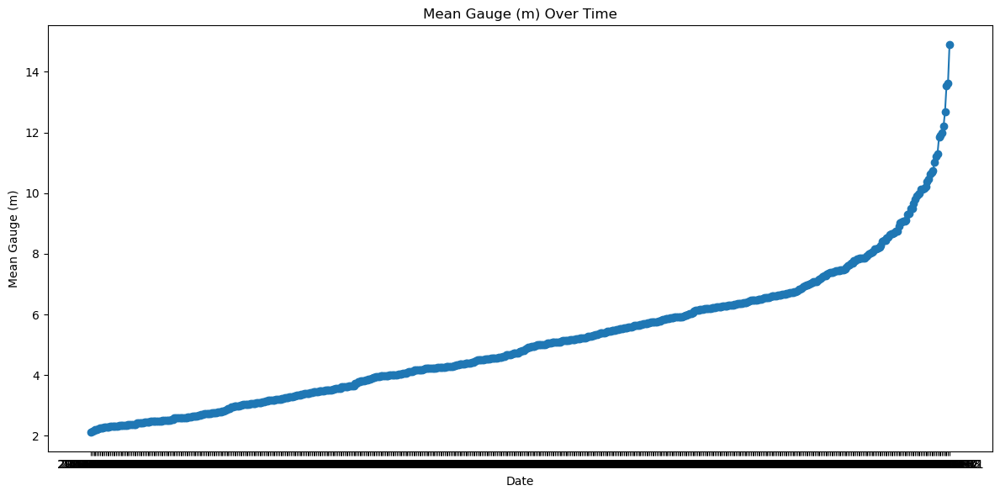

In [8]:
# Plot the "Mean Gauge (m)" data as a date plot
plt.figure(figsize=(12, 6))
plt.plot(filtered_df['Date'], filtered_df['Mean_Gauge'], marker='o', linestyle='-')
plt.title('Mean Gauge (m) Over Time')
plt.xlabel('Date')
plt.ylabel('Mean Gauge (m)')
# plt.grid(True)
# plt.xticks(rotation=45)
# plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b %Y'))

# Show the plot
plt.tight_layout()
plt.show()



In [9]:
# Stores the ground truth image with the corresponding gauge measurement.
@dataclasses.dataclass
class GroundTruthMeasurement:
    ground_truth: np.ndarray
    gauge_measurement: float
    date: str  

In [10]:
def load_inundation_maps(file_list):
    inundation_maps = []
    base_path = 'June_Sep_2001_2012_binary_resized'
    for file in file_list:
        if file.endswith(".tif"):
            file_path = os.path.join(base_path, file)  # Correct file path
            with rasterio.open(file_path) as src:
                inundation_map = src.read(1)
            inundation_maps.append(inundation_map)
    return inundation_maps

def load_gauge_measurements(input_data):
    return input_data.set_index("filename")["Mean_Gauge"].to_dict()

In [11]:
# inundation_maps = load_inundation_maps(file_list)
# inundation_maps

# gauge_measurements = load_gauge_measurements(filtered_df)
# gauge_measurements

In [12]:
filename_array=filtered_df['filename']
file_list = filename_array.tolist()

inundation_maps = load_inundation_maps(file_list)

# Load gauge measurements from the CSV file
gauge_measurements = load_gauge_measurements(filtered_df)

GROUND_TRUTH = [
    GroundTruthMeasurement(
        ground_truth=inundation_map,
        gauge_measurement=gauge_measurements[filename],
        date=re.search(r'\((\d{2}[A-Z]{3}\d{4})', filename).group(1)
    )
    for filename, inundation_map in zip(file_list, inundation_maps)
]

/Users/amanchaudhary/anaconda3/lib/python3.10/site-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [13]:
GROUND_TRUTH

[GroundTruthMeasurement(ground_truth=array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), gauge_measurement=2.13, date='09JUN2012'),
 GroundTruthMeasurement(ground_truth=array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), gauge_measurement=2.15, date='27JUN2006'),
 GroundTruthMeasurement(ground_truth=array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8), gauge_measurement=2.19, date='16JUN2007'),
 GroundTruthMeasurement(ground_truth=array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0

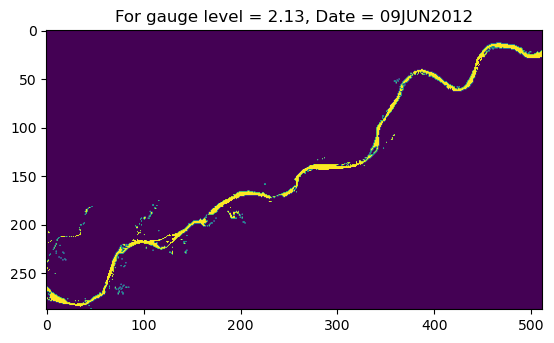

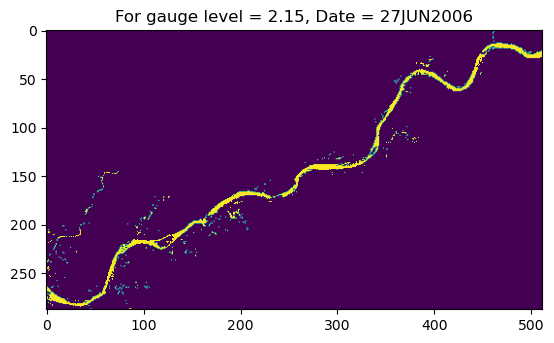

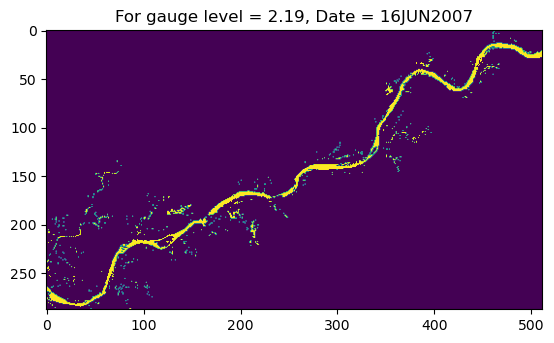

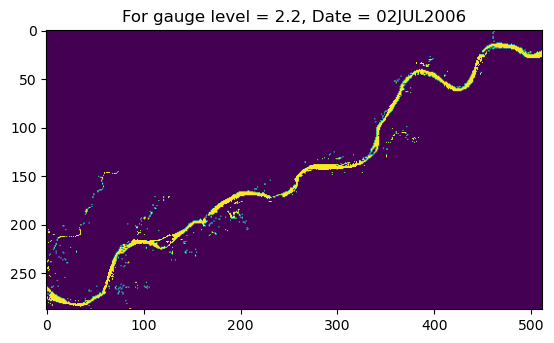

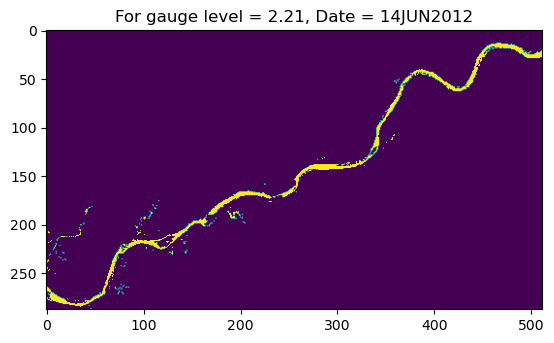

...

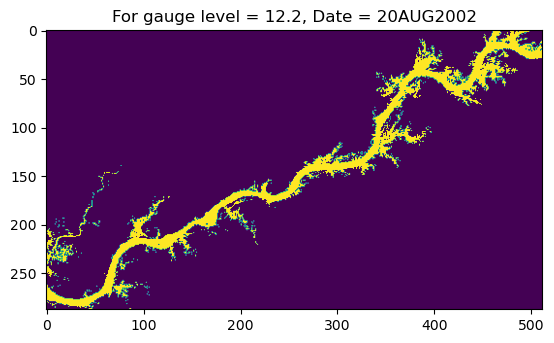

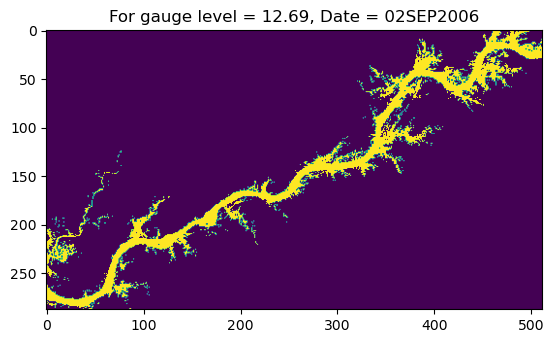

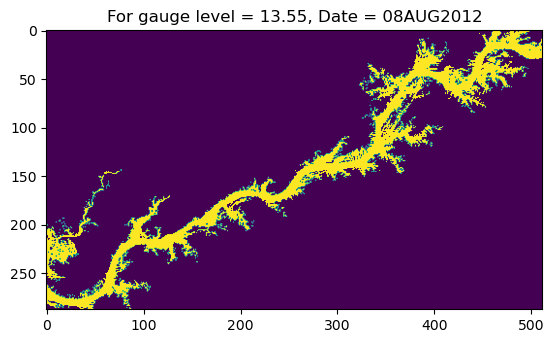

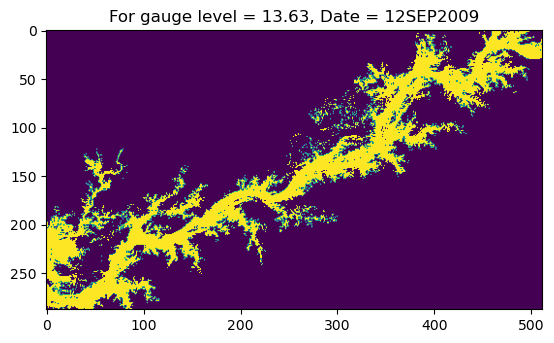

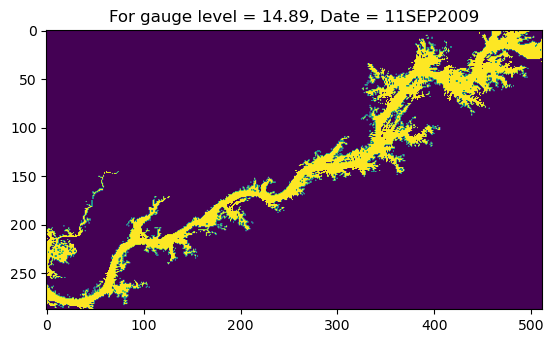

In [14]:
for gt in GROUND_TRUTH:
    plt.imshow(gt.ground_truth)
    plt.title(f'For gauge level = {gt.gauge_measurement}, Date = {gt.date}')  # Include the date in the title
    plt.show()
# x-axis and y-axis of the image plot showing pixel coordinates.

# Thresholding Model


In [15]:
# pip install absl-py

In [16]:
"""Library functions for predicting flood extent based on historical data."""
from typing import Optional, Sequence, Tuple

from absl import logging
import numpy as np

# Range above heighest measurement and below lowest measurement in which we expect to get measurements.
_MEASUREMENT_BUFFER_METERS = 10

# A number that is smaller than the uncertainty bound of a gauge measurement.
_EPSILON = 0.002


def get_cutoff_points(
    measurements: np.ndarray,
    precision_oriented: bool) -> Tuple[Sequence[int], np.ndarray]:
  """Gets all valid cutoff points and threshold values.

  A cutoff point is the index of a measurement at which we can separate lower
  measurements from higher measurements. For a cutoff point i, the matching
  threshold value must be greater or equal to measurement[i-1] and less than
  measurement[i]. Thus, the i'th event is the first wet event.

  The corresponding threshold value is a gauge measurement value which separates
  examples up to the given cutoff from those above the given cutoff.

  Args:
    measurements: All obtained measurements in the training set, sorted in
      ascending order.
    precision_oriented: if true, select the i'th cutoff to be measurements[i] -
      _EPSILON, otherwise the i'th cutoff is measurements[i-1]

  Raises:
    ValueError: If measurements are not sorted.

  Returns:
    cutoff_points: Indices at which there exists a threshold which separates
      between positive and negative measurements. The length of the list is the
      number of distinct measurements plus 1.
    threshold_values: Gauge measurement values which separate at those cutoffs.
      Shape is (num_cutoffs,).
  """
  # `measurements` is sorted in ascending order. Let's just verify this.
  if np.any(np.diff(measurements) < 0):
    raise ValueError('Expected measurements to be sorted: %r' % measurements)

  # Add an artificially low threshold value, to be used for pixels which should
  # always be wet.
  threshold_values = [measurements[0] - _MEASUREMENT_BUFFER_METERS]
  cutoff_points = [0]

  differing_measurements = ~np.isclose(measurements[:-1], measurements[1:])
  differing_locations = np.nonzero(differing_measurements)[0]
  cutoff_points.extend(differing_locations + 1)
  # For cutoffs higher than the lowest event and lower than the highest event,
  # any threshold value between measurements[i] and measurements[i+1] can be
  # used.
  if precision_oriented:
    # To be as conservative as possible, we choose measurements[i+1] - _EPSILON,
    # in order to include as small a region as possible in the risk map.
    threshold_values.extend(measurements[differing_locations + 1] - _EPSILON)
  else:
    # To alert as much as possible, we choose measurements[i],
    # in order to include as large a region as possible in the risk map.
    threshold_values.extend(measurements[differing_locations])

  # Add the final threshold. When not precision oriented, above the highest
  # event all pixels should be considered inundated. When precision oriented,
  # above the inundation map should be equal to that of the highest event.
  threshold_values.append(measurements[-1])
  if precision_oriented:
    threshold_values[-1] += _MEASUREMENT_BUFFER_METERS
  cutoff_points.append(len(measurements))

  logging.info('Found %d threshold values: %r', len(threshold_values),
               np.asarray(threshold_values))

  return cutoff_points, np.asarray(threshold_values, dtype=np.float)


def _count_true_in_suffixes(imaps: np.ndarray,
                            cutoff_points: Sequence[int]) -> np.ndarray:
  """Returns the number of True's above the cutoff at each pixel.

  Args:
    imaps: Observed inundation maps for all training set flood events, sorted by
      increasing gauge measurement. Shape is (num_train_examples,height,width)
      for 3d arrays, or (num_train_examples,) for 1d arrays.
    cutoff_points: Indices into the first axis of `imaps`, at which it is
      possible to separate between lower and higher flood events. This includes
      all indices except those having identical gauge measurements as the
      subsequent event.

  Returns:
    Array with the same shape as imaps, where the first axis has shape
    num_cutoffs instead of num_train_examples. For example, if imaps is an array
    with shape (num_train_examples, height, width), the result is an array with
    shape (num_cutoffs, height, width) whose [c,i,j] element is the number of
    events whose pixel [i,j] is True above cutoff c.
  """
  all_count_true = np.nancumsum(imaps[::-1], axis=0)[::-1]
  # If the suffix is empty, the number of True's is zero.
  filler_zeros = np.expand_dims(np.zeros_like(all_count_true[0]), 0)
  all_count_true = np.concatenate([all_count_true, filler_zeros])
  return all_count_true.take(cutoff_points, axis=0, mode='clip')


def count_true_wets_per_cutoff(imaps: np.ndarray,
                               cutoff_points: Sequence[int]) -> np.ndarray:
  """Returns the number of wets observations of each pixel above each cutoff.

  Wet observations of a pixel above a given cutoff can be thought of as "true
  wet" decisions for that cutoff value.

  Args:
    imaps: Observed inundation maps for all training set flood events, sorted by
      increasing gauge measurement. Shape is (num_train_examples,height,width)
      for 3d arrays, or (num_train_examples,) for 1d arrays.
    cutoff_points: Indices into the first axis of `imaps`, at which it is
      possible to separate between lower and higher flood events. This includes
      all indices except those having identical gauge measurements as the
      subsequent event.

  Returns:
    Array with the same shape as imaps, where the first axis has shape
    num_cutoffs instead of num_train_examples. For example, if imaps is an array
    with shape (num_train_examples, height, width), the result is an array with
    shape (num_cutoffs, height, width) whose [c,i,j] element is the number of
    events whose pixel [i,j] is wet above cutoff c.
  """
  return _count_true_in_suffixes(imaps, cutoff_points)


def count_false_wets_per_cutoff(imaps: np.ndarray,
                                cutoff_points: Sequence[int]) -> np.ndarray:
  """Returns the number of dry observations of each pixel above each cutoff.

  Dry observations of a pixel above a given cutoff can be thought of as "false
  wet" decisions for that cutoff value.

  Args:
    imaps: Observed inundation maps for all training set flood events, sorted by
      increasing gauge measurement. Shape is (num_train_examples,height,width)
      for 3d arrays, or (num_train_examples,) for 1d arrays.
    cutoff_points: Indices into the first axis of `imaps`, at which it is
      possible to separate between lower and higher flood events. This includes
      all indices except those having identical gauge measurements as the
      subsequent event.

  Returns:
    Array with the same shape as imaps, where the first axis has shape
    num_cutoffs instead of num_train_examples. For example, if imaps is an array
    with shape (num_train_examples, height, width), the result is an array with
    shape (num_cutoffs, height, width) whose [c,i,j] element is the number of
    events whose pixel [i,j] is wet below cutoff c.
  """
  not_imaps = 1 - imaps
  return _count_true_in_suffixes(not_imaps, cutoff_points)


def count_false_drys_per_cutoff(imaps: np.ndarray,
                                cutoff_points: Sequence[int]) -> np.ndarray:
  """Returns the number of wet observations of each pixel below each cutoff.

  Wet observations of a pixel below a given cutoff can be thought of as "false
  dry" decisions for that cutoff value.

  Args:
    imaps: Observed inundation maps for all training set flood events, sorted by
      increasing gauge measurement. Shape is (num_train_examples,height,width)
      for 3d arrays, or (num_train_examples,) for 1d arrays.
    cutoff_points: Indices into the first axis of `imaps`, at which it is
      possible to separate between lower and higher flood events. This includes
      all indices except those having identical gauge measurements as the
      subsequent event.

  Returns:
    Array with the same shape as imaps, where the first axis has shape
    num_cutoffs instead of num_train_examples .For example, if imaps is an array
    with shape (num_train_examples, height, width), the result is an array with
    shape (num_cutoffs, height, width) whose [c,i,j] element is the number of
    events whose pixel [i,j] is dry above cutoff c.
  """
  all_count_false_drys = np.nancumsum(imaps, axis=0)
  # If the cutoff is lower than all events, the number of false drys is zero.
  filler_zeros = np.expand_dims(np.zeros_like(all_count_false_drys[0]), 0)
  all_count_false_drys = np.concatenate([filler_zeros, all_count_false_drys])
  return all_count_false_drys.take(cutoff_points, axis=0, mode='clip')


def _get_pixel_threshold_index(pixel_events: np.ndarray,
                               cutoff_points: np.ndarray,
                               min_ratio: float) -> int:
  """Calculates the threshold index in cutoff_points for a single pixel.

  Args:
    pixel_events: 1D array of the inundation at the pixel for all events, by
      increasing gauge order.
    cutoff_points: Indices into the first axis of `imaps`, at which it is
      possible to separate between lower and higher flood events. This includes
      all indices except those having identical gauge measurements as the
      subsequent event.
    min_ratio: Select the threshold at each pixel such that the ratio between
      added true positives and added false positives is above min_ratio.

  Returns:
    Index within cutoff_points of the threshold of the given pixel.
  """
  while np.nansum(pixel_events):
    true_wets = count_true_wets_per_cutoff(pixel_events, cutoff_points)
    false_wets = count_false_wets_per_cutoff(pixel_events, cutoff_points)
    ratios = true_wets / false_wets
    # The empty slice, corresponding to ratios[-1], has 0 true wets and 0 false
    # wets. We define the ratio there to be 0, as we want any slice that
    # contain a true wet to have a higher ratio than the empty slice.
    ratios[-1] = 0
    # Take the last maximum. In the case we have d, nan, w, we want the
    # threshold to be between nan and w, despite the fact that the threshold
    # between d and nan has the same ratio.
    best_index = ratios.shape[0] - 1 - np.nanargmax(ratios[::-1])

    if ratios[best_index] < min_ratio:
      break
    # Find the next candidate threshold on the prefix of all events below the
    # current best cutoff point.
    best_cutoff_point = cutoff_points[best_index]
    pixel_events = pixel_events[:best_cutoff_point]
    cutoff_points = cutoff_points[:best_index + 1]
  # If the remaining slice contains only NaNs, pixel should always be
  # inundated.
  if np.all(np.isnan(pixel_events)):
    return 0
  return len(cutoff_points) - 1


def _get_threshold_indices(imaps: np.ndarray, cutoff_points: np.ndarray,
                           min_ratio: float) -> np.ndarray:
  """Calculates the threshold index in cutoff_points for all pixels.

  Args:
    imaps: Observed inundation maps for all training set flood events, sorted by
      increasing gauge measurement. Shape is (num_train_examples,height,width).
    cutoff_points: Indices into the first axis of `imaps`, at which it is
      possible to separate between lower and higher flood events. This includes
      all indices except those having identical gauge measurements as the
      subsequent event.
    min_ratio: Select the threshold at each pixel such that the ratio between
      added true positives and added false positives is above min_ratio.

  Returns:
    threshold_indices: Array of threshold indices within cutoff_points for
      each pixel. Shape is (height, width).
  """
  threshold_indices = np.zeros_like(imaps[0, :, :], dtype=int)
  for idx_y in range(threshold_indices.shape[0]):
    for idx_x in range(threshold_indices.shape[1]):
      threshold_indices[idx_y, idx_x] = _get_pixel_threshold_index(
          imaps[:, idx_y, idx_x], cutoff_points, min_ratio)
  return threshold_indices


def _learn_optimal_sar_prediction_internal(imaps: np.ndarray,
                                           measurements: np.ndarray,
                                           min_ratio: float) -> np.ndarray:
  """A version of learn_sar_prediction without the external data structures.

  Selects the threshold such that the number of added true positives divided by
  the number of added false positives is at least min_ratio.

  Args:
    imaps: Observed inundation maps for all training set flood events, sorted by
      increasing gauge measurement. Shape is (num_train_examples,height,width).
    measurements: All obtained measurements in the training set, sorted in
      ascending order.
    min_ratio: Selects the threshold at each pixel such that the ratio between
      added true positives and added false positives is above min_ratio.

  Returns:
    Array of thresholds for each pixel. Shape is (height, width).
  """
  cutoff_points, threshold_values = get_cutoff_points(
      measurements, precision_oriented=True)

  threshold_indices = _get_threshold_indices(imaps, np.array(cutoff_points),
                                             min_ratio)
  thresholds = threshold_values[threshold_indices]

  if np.issubdtype(imaps.dtype, np.floating):
    # If all inundation maps are NaN for a given pixel, make the threshold for
    # that pixel a NaN as well. This occurs when the pixel is outside the
    # requested forecast_region.
    thresholds = np.where(np.all(np.isnan(imaps), axis=0), np.nan, thresholds)

  return thresholds


def masked_array_to_float_array(masked_array):
  float_array = np.array(masked_array, dtype=float)
  mask = np.ma.getmaskarray(masked_array)
  float_array[mask] = np.nan
  return float_array


def learn_optimal_sar_prediction_from_ground_truth(
    flood_events_train: Sequence[GroundTruthMeasurement],
    min_ratio: Optional[float] = None) -> np.ndarray:
    
    # Sort the gauge measurements in ascending order
    measurements = np.asarray(sorted([fe.gauge_measurement for fe in flood_events_train]))
    
    # Rest of your code remains unchanged
    imaps = np.asarray([
        masked_array_to_float_array(fe.ground_truth) for fe in flood_events_train
    ])

    return _learn_optimal_sar_prediction_internal(imaps, measurements, min_ratio)



### Optimal min_ratio code

In [17]:
# MIN_RATIOS = [0.1, 0.3, 0.5, 1, 2, 5, 10, 15,20]
MIN_RATIOS = [1]

class ThresholdingModel:
    def f1_metric(self, ground_truths: Sequence[GroundTruthMeasurement],
                  thresholds: np.ndarray) -> float:
        """Returns the aggregated F1 metric for a set of thresholds."""
        relevant_true = predicted_true = true_positives = 0
        for gt in ground_truths:
            predicted = thresholds < gt.gauge_measurement
            actual = gt.ground_truth.astype(bool)
            true_positives += np.sum(predicted & actual)
            predicted_true += np.sum(predicted)
            relevant_true += np.sum(actual)
        
        total_precision = true_positives / predicted_true
        total_recall = true_positives / relevant_true
        return 2/(1/total_precision + 1/total_recall)

    def train(self, ground_truth: Sequence[GroundTruthMeasurement]):
        """Trains the model according to the provided training set."""
        min_ratio_to_thresholds = {}
        f1_to_min_ratio = {}
        for min_ratio in MIN_RATIOS:
            min_ratio_to_thresholds[min_ratio] = (
                learn_optimal_sar_prediction_from_ground_truth(GROUND_TRUTH, 
                                                               min_ratio))
            f1 = self.f1_metric(ground_truth, 
                                min_ratio_to_thresholds[min_ratio])
            print(f'For min_ratio={min_ratio} we get f1={f1}')
            f1_to_min_ratio[f1] = min_ratio
        
        best_f1 = max(f1_to_min_ratio.keys())
        best_min_ratio = f1_to_min_ratio[best_f1]
        print('chosen min_ratio', best_min_ratio)
        self.thresholds = min_ratio_to_thresholds[best_min_ratio]
    
    def infer(self, gauge_level: float):
        """Returns the inferred inundation model for a gauge level."""
        return self.thresholds < gauge_level

In [18]:
#@title train over dummy dataset
tm = ThresholdingModel()
tm.train(GROUND_TRUTH)

/var/folders/_s/v895zwy14cl5h2nzfq54qq500000gn/T/ipykernel_61758/1375059047.py:78: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  return cutoff_points, np.asarray(threshold_values, dtype=np.float)
/var/folders/_s/v895zwy14cl5h2nzfq54qq500000gn/T/ipykernel_61758/1375059047.py:212: RuntimeWarning: divide by zero encountered in divide
  ratios = true_wets / false_wets
/var/folders/_s/v895zwy14cl5h2nzfq54qq500000gn/T/ipykernel_61758/1375059047.py:212: RuntimeWarning: invalid value encountered in divide
  ratios = true_wets / false_wets


For min_ratio=1 we get f1=0.9450039797222949
chosen min_ratio 1


# Predicted Inundation Maps

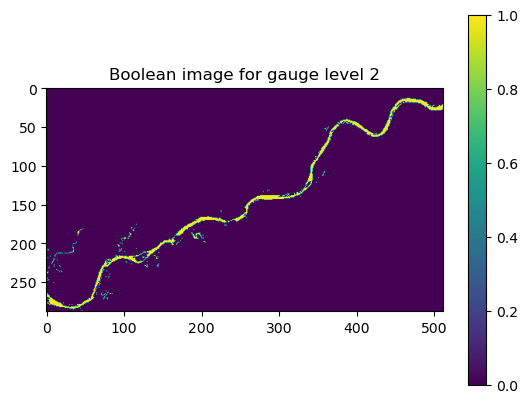

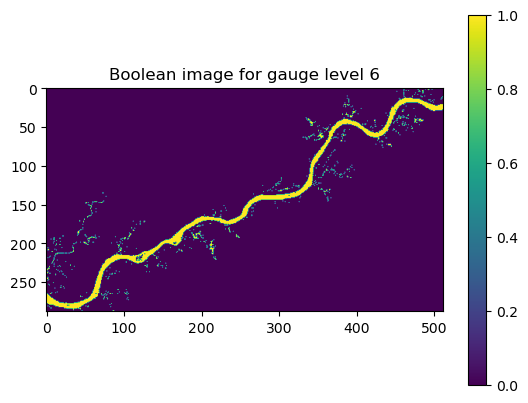

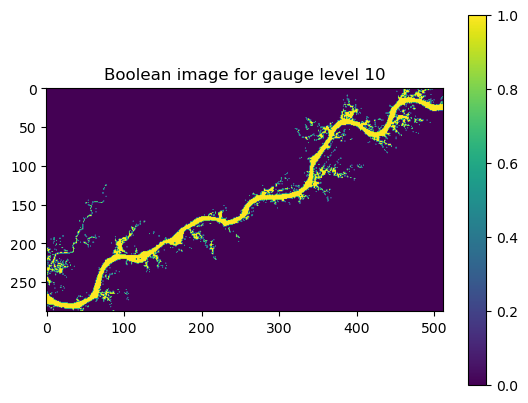

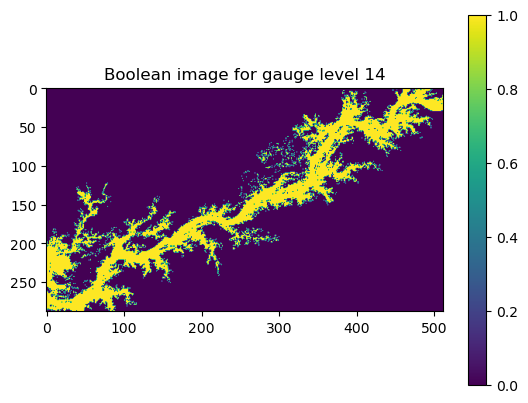

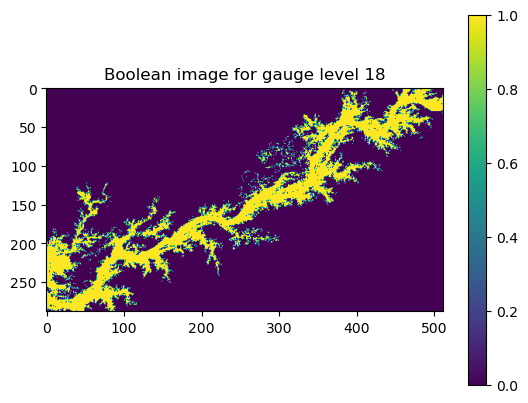

In [19]:
# for gauge_level in test_gauge_measurement_array:
for gauge_level in [2,6,10,14,18]:
    plt.title(f'Boolean image for gauge level {gauge_level}')
    plt.imshow(tm.infer(gauge_level))
    plt.colorbar()
    plt.show()

# Exporting Predicted Inundation Maps

In [22]:
from rasterio import Affine, MemoryFile

# 8 August 2012
gauge_measurement=13.55

# 29 August 2020
# gauge_measurement=13.04
# gauge_measurement=14.4



predicted_result=tm.infer(gauge_measurement)

# Get the transformation, width, height, and data type from the input raster
with rasterio.open("June_Sep_2001_2012_binary_resized/Inundation Boundary (01AUG2012 00 00 00 Value_0).tif") as src:
    transform = src.transform
    width = src.width
    height = src.height

# Create a new in-memory GeoTIFF file for the prediction
with MemoryFile() as memfile:
    with memfile.open(
        driver="GTiff",
        width=width,
        height=height,
        count=1,  # Number of bands
        dtype='uint8',
        crs=src.crs,
        #crs="EPSG:4326",
        transform=transform,
    ) as dst:
        # Write the predicted result to the GeoTIFF
        dst.write(predicted_result, 1)


    # Save the in-memory GeoTIFF to the specified output path
    with open("predicted_inundation_map.tif", "wb") as f:
        f.write(memfile.read())

/Users/amanchaudhary/anaconda3/lib/python3.10/site-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/Users/amanchaudhary/anaconda3/lib/python3.10/site-packages/rasterio/io.py:141: NotGeoreferencedWarning: The given matrix is equal to Affine.identity or its flipped counterpart. GDAL may ignore this matrix and save no geotransform without raising an error. This behavior is somewhat driver-specific.
  return writer(


In [29]:
import rasterio
import numpy as np
from scipy.ndimage import zoom
import matplotlib.pyplot as plt

def load_tif_with_rasterio(file_path):
    """Load a TIF file using rasterio and return its data as a numpy array."""
    with rasterio.open(file_path) as dataset:
        array = dataset.read(1)  # Read the first band
    return array

def calculate_f1_score(actual, predicted):
    TP = np.sum((actual == 1) & (predicted == 1))
    FP = np.sum((actual == 0) & (predicted == 1))
    FN = np.sum((actual == 1) & (predicted == 0))

    precision = TP / (TP + FP) if (TP + FP) != 0 else 0
    recall = TP / (TP + FN) if (TP + FN) != 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) != 0 else 0
    return f1

# Function to resize array
def resize_array(array, target_shape):
    y_scale = target_shape[0] / array.shape[0]
    x_scale = target_shape[1] / array.shape[1]
    resized_array = zoom(array, (y_scale, x_scale))
    return resized_array

# Load the actual and predicted TIF files

actual_array = load_tif_with_rasterio('afterWaterBinary_UTM_RiverClipped_5km_buffer.tif')
predicted_array = load_tif_with_rasterio('predicted_inundation_map.tif')

# actual_array = load_tif_with_rasterio('June_Sep_2001_2012_binary_resized/Inundation Boundary (08AUG2012 00 00 00 Value_0).tif')
# predicted_array = load_tif_with_rasterio('predicted_inundation_map.tif')



# Resize the actual array to match the predicted array
resized_actual_array = resize_array(actual_array, predicted_array.shape)

# Calculate and print the F1 Score
f1_score = calculate_f1_score(resized_actual_array, predicted_array)
print("F1 Score:", f1_score)


F1 Score: 0.42027902341803686


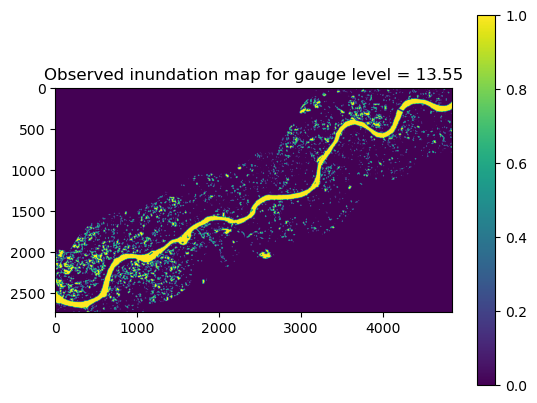

In [30]:

plt.imshow(actual_array)
plt.title(f'Observed inundation map for gauge level = {gauge_measurement}')
plt.colorbar()
plt.show()

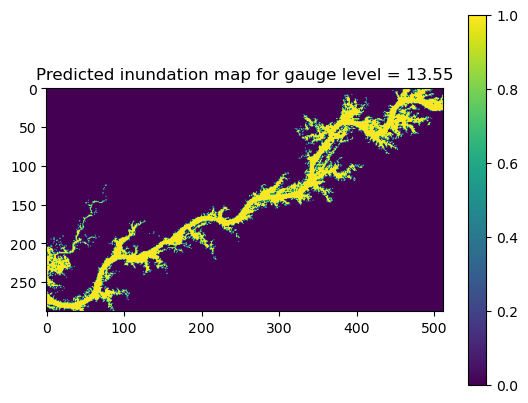

In [31]:

plt.imshow(predicted_array)
plt.title(f'Predicted inundation map for gauge level = {gauge_measurement}')
plt.colorbar()
plt.show()

# Visualize TIF Raster file

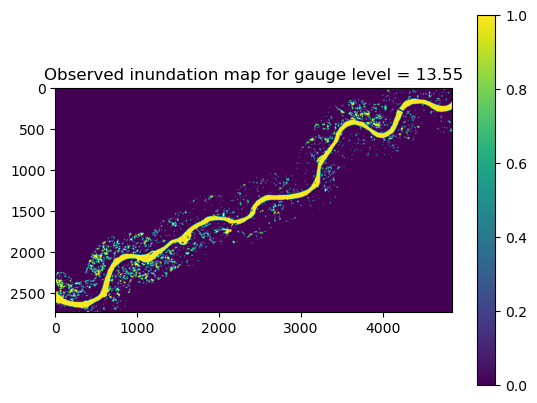

In [32]:
with rasterio.open("afterWaterBinary_UTM_RiverClipped_2.5km_buffer.tif") as dataset:
    array = dataset.read(1)  # Read the first band
    plt.imshow(array)
    plt.title(f'Observed inundation map for gauge level = {gauge_measurement}')
    plt.colorbar()
    plt.show()